In [ ]:
!nvidia-smi

Mon Aug 12 19:53:10 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   50C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
import torch

# Check PyTorch GPU availability
if torch.cuda.is_available():
    print(f"GPU Name: {torch.cuda.get_device_name(0)}")
    print(f"GPU Is Available: {torch.cuda.is_available()}")
else:
    print("GPU is not available.")

GPU Name: Tesla T4
GPU Is Available: True


In [ ]:
import os
import shutil

# Define source directory and target directories
src_dir = '/content/obj_train_data'
images_dir = '/content/dataset/images'
labels_dir = '/content/dataset/labels'

# Create target directories if they don't exist
os.makedirs(images_dir, exist_ok=True)
os.makedirs(labels_dir, exist_ok=True)

# Separate images and annotations
for file_name in os.listdir(src_dir):
    if file_name.endswith('.jpg'):
        shutil.move(os.path.join(src_dir, file_name), images_dir)
    elif file_name.endswith('.txt'):
        shutil.move(os.path.join(src_dir, file_name), labels_dir)

In [ ]:
import os
from PIL import Image
from torchvision import transforms

source_dir = 'dataset/images'
target_dir = 'Agumented images'
source_dir2 = 'dataset/labels'
target_dir2='Agumented labels'


os.makedirs(target_dir, exist_ok=True)
os.makedirs(target_dir2, exist_ok=True)


augmentation_list = [
    transforms.ColorJitter(brightness=(0.5, 1.5)),  # Increase and decrease brightness
    transforms.ColorJitter(contrast=(0.5, 1.5)),    # Increase and decrease contrast
    transforms.ColorJitter(saturation=(0.5, 1.5)),  # Increase and decrease saturation
    transforms.ColorJitter(hue=(-0.1, 0.1))         # Increase and decrease hue
]

# Iterate over all images in the source directory
for filename in os.listdir(source_dir):
    if filename.endswith('.jpg') or filename.endswith('.png'):  # Add more extensions if needed
        # Load image
        img_path = os.path.join(source_dir, filename)
        image = Image.open(img_path)

        # Remove the extension from the filename
        file_name_without_ext = os.path.splitext(filename)[0]


        for i, augmentation in enumerate(augmentation_list):
            augmented_image = augmentation(image)
            augmented_img_path = os.path.join(target_dir, f'aug_{i}_{file_name_without_ext}.png')
            augmented_image.save(augmented_img_path)

            for filename2 in os.listdir(source_dir2):
                file_name_without_ext2 = os.path.splitext(filename2)[0]
                if file_name_without_ext == file_name_without_ext2:
                    text_path = os.path.join(source_dir2, filename2)
                    with open(text_path, 'r') as text_file:
                        text_content = text_file.read()
                    augmented_text_path = os.path.join(target_dir2, f'aug_{i}_{file_name_without_ext2}.txt')
                    with open(augmented_text_path, 'w') as augmented_text_file:
                        augmented_text_file.write(text_content)


print("Process done")


Process done


In [ ]:
import random
def split_data(augmented_img_dir, augmented_label_dir, train_ratio=0.7, val_ratio=0.2):
    images = [f for f in os.listdir(augmented_img_dir) if f.endswith('.png')]
    random.shuffle(images)  # Random module is used here

    total_count = len(images)
    train_count = int(total_count * train_ratio)
    val_count = int(total_count * val_ratio)
    test_count = total_count - train_count - val_count

    train_dir = os.path.join('train')
    val_dir = os.path.join('val')
    test_dir = os.path.join('test')

    os.makedirs(train_dir, exist_ok=True)
    os.makedirs(val_dir, exist_ok=True)
    os.makedirs(test_dir, exist_ok=True)

    os.makedirs(os.path.join(train_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(val_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(test_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(train_dir, 'labels'), exist_ok=True)
    os.makedirs(os.path.join(val_dir, 'labels'), exist_ok=True)
    os.makedirs(os.path.join(test_dir, 'labels'), exist_ok=True)

    def move_files(files, destination_dir):
        for filename in files:
            image_src = os.path.join(augmented_img_dir, filename)
            image_dst = os.path.join(destination_dir, 'images', filename)

            label_filename = os.path.splitext(filename)[0] + '.txt'
            label_src = os.path.join(augmented_label_dir, label_filename)
            label_dst = os.path.join(destination_dir, 'labels', label_filename)

            # Check if both the image and label exist before moving
            if os.path.exists(image_src) and os.path.exists(label_src):
                shutil.move(image_src, image_dst)
                shutil.move(label_src, label_dst)
            else:
                print(f"Warning: Missing label file for {filename}, skipping...")

    move_files(images[:train_count], train_dir)
    move_files(images[train_count:train_count + val_count], val_dir)
    move_files(images[train_count + val_count:], test_dir)

    return train_count, val_count, test_count

train_count, val_count, test_count = split_data(target_dir, target_dir2)

print(f"Process done and data split into train, val, and test folders.")
print(f"Number of images in Train: {train_count}")
print(f"Number of images in Validation: {val_count}")
print(f"Number of images in Test: {test_count}")

Process done and data split into train, val, and test folders.
Number of images in Train: 2095
Number of images in Validation: 598
Number of images in Test: 301


In [ ]:
pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.3/41.3 kB 2.5 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.

In [ ]:
from ultralytics import YOLO

In [ ]:
data_yaml = """
train: /content/train/images
val: /content/val/images

nc: 7  # Number of classes
names: ['bench', 'tree_log', 'tree_trunk', 'garbage_bin', 'rock', 'pole', 'bush']
"""

# Save the YAML configuration
with open('/content/data.yaml', 'w') as file:
    file.write(data_yaml)

In [ ]:
model = YOLO("yolov8n.pt")

100%|██████████| 6.25M/6.25M [00:00<00:00, 97.4MB/s]


In [ ]:
model.tune(data="data.yaml", epochs=50, iterations=1, optimizer="AdamW", imgsz=640)

Tuner: Initialized Tuner instance with 'tune_dir=runs/detect/tune2'
Tuner: 💡 Learn about tuning at https://docs.ultralytics.com/guides/hyperparameter-tuning
Tuner: Starting iteration 1/1 with hyperparameters: {'lr0': 0.01, 'lrf': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8, 'box': 7.5, 'cls': 0.5, 'dfl': 1.5, 'hsv_h': 0.015, 'hsv_s': 0.7, 'hsv_v': 0.4, 'degrees': 0.0, 'translate': 0.1, 'scale': 0.5, 'shear': 0.0, 'perspective': 0.0, 'flipud': 0.0, 'fliplr': 0.5, 'bgr': 0.0, 'mosaic': 1.0, 'mixup': 0.0, 'copy_paste': 0.0}
Saved runs/detect/tune2/tune_scatter_plots.png
Saved runs/detect/tune2/tune_fitness.png

Tuner: 1/1 iterations complete ✅ (3431.04s)
Tuner: Results saved to runs/detect/tune2
Tuner: Best fitness=0.61954 observed at iteration 1
Tuner: Best fitness metrics are {'metrics/precision(B)': 0.89746, 'metrics/recall(B)': 0.85073, 'metrics/mAP50(B)': 0.91392, 'metrics/mAP50-95(B)': 0.58683, 'val/box_loss': 1.36464, 'val/cls_loss'

In [ ]:
!yolo predict model=runs/detect/train2/weights/best.pt source='/content/test/images'


Ultralytics YOLOv8.2.76 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,007,013 parameters, 0 gradients, 8.1 GFLOPs

image 1/299 /content/test/images/aug_0_image_20240618_142142.png: 480x640 1 bench, 8 tree_trunks, 1 rock, 4 poles, 1 bush, 57.6ms
image 2/299 /content/test/images/aug_0_image_20240618_142157.png: 480x640 1 bench, 2 tree_trunks, 2 poles, 2 bushs, 7.9ms
image 3/299 /content/test/images/aug_0_image_20240618_142218.png: 480x640 14 tree_trunks, 2 rocks, 6.5ms
image 4/299 /content/test/images/aug_0_image_20240618_142219.png: 480x640 5 tree_trunks, 1 rock, 3 poles, 1 bush, 6.7ms
image 5/299 /content/test/images/aug_0_image_20240618_142239.png: 480x640 1 bench, 3 tree_trunks, 1 pole, 2 bushs, 6.2ms
image 6/299 /content/test/images/aug_0_image_20240618_142250.png: 480x640 3 tree_trunks, 3 poles, 2 bushs, 6.8ms
image 7/299 /content/test/images/aug_0_image_20240618_142303.png: 480x640 1 bench, 3 tree_trunks, 1 rock, 2 poles, 1 bus

In [ ]:
import yaml

# Load the YAML file
with open('runs/detect/tune2/best_hyperparameters.yaml', 'r') as file:
    lines = file.readlines()

# Initialize variables
precision = None
recall = None

# Extract the relevant metrics
for line in lines:
    if 'metrics/precision(B)' in line:
        precision = float(line.split(': ')[1].split(',')[0].strip())
    if 'metrics/recall(B)' in line:
        recall = float(line.split(': ')[1].split(',')[0].strip())

# Check if precision and recall were found
if precision is None or recall is None:
    print("Precision or Recall not found in the file.")
else:
    # Total number of samples
    total_samples = 596  # Replace with actual total number of samples

    # Calculate estimates
    tp_estimate = precision * recall * total_samples  # Simplified estimate for demonstration
    fp_estimate = (tp_estimate / precision) - tp_estimate  # Estimate using precision
    fn_estimate = (tp_estimate / recall) - tp_estimate  # Estimate using recall
    tn_estimate = total_samples - tp_estimate - fp_estimate - fn_estimate

    # Calculate estimated accuracy
    accuracy_estimate = (tp_estimate + tn_estimate) / total_samples

    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"Estimated Accuracy: {accuracy_estimate:.4f}")


Precision: 0.8975
Recall: 0.8975
Estimated Accuracy: 0.8159


In [ ]:
pip install opencv-python


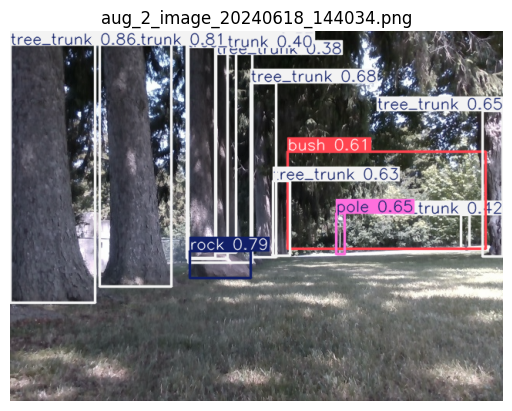

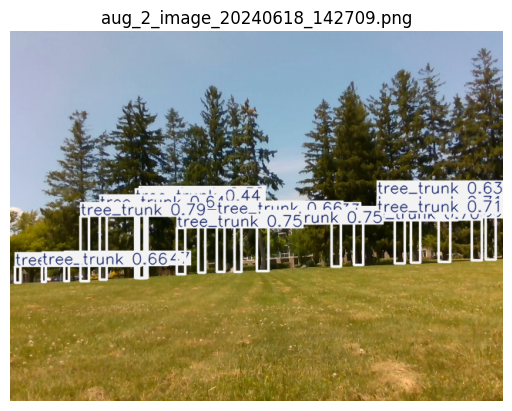

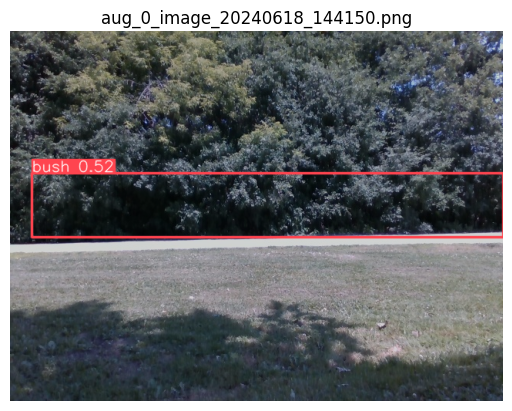

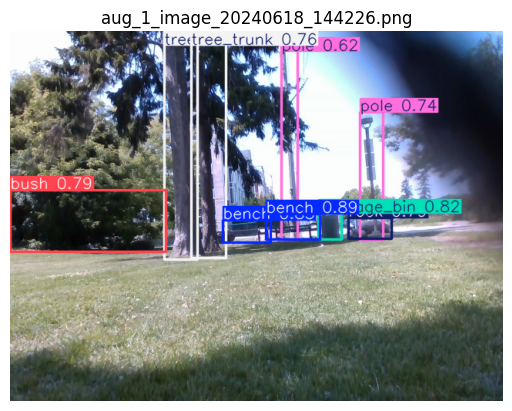

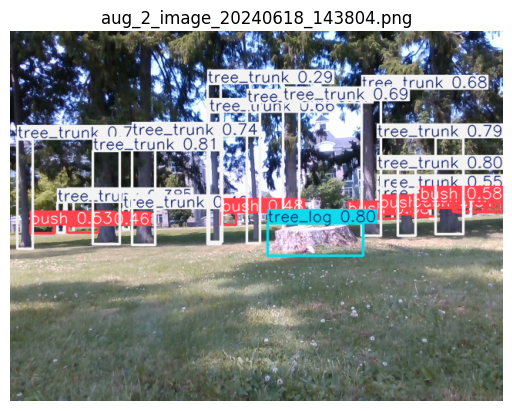

...

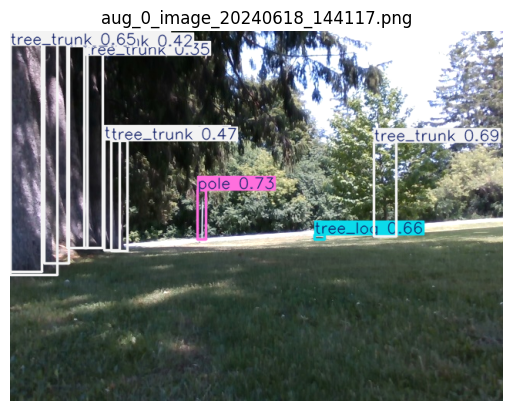

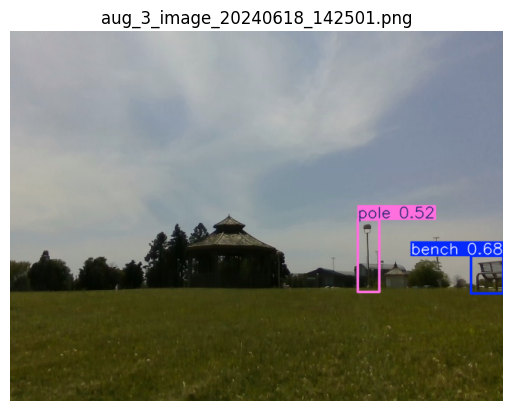

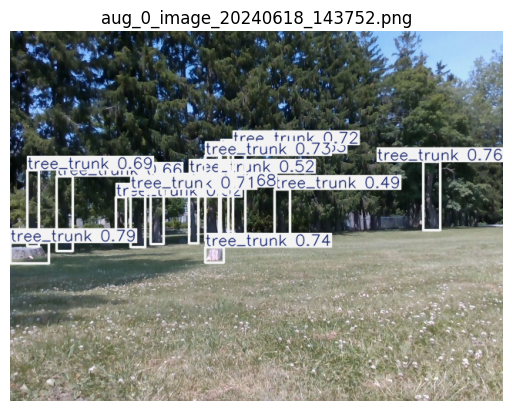

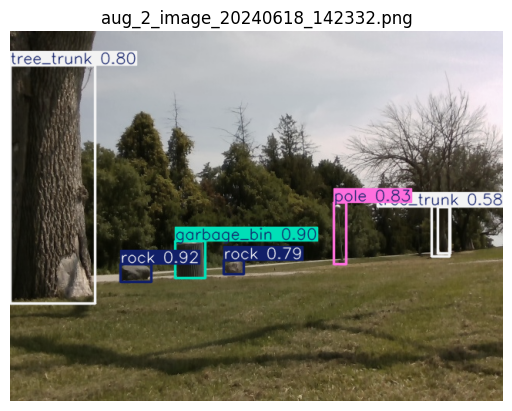

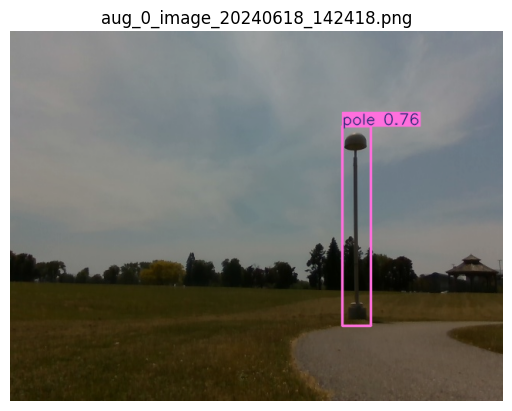

Buffered data was truncated after reaching the output size limit.

In [ ]:
import cv2
import os
import matplotlib.pyplot as plt

# Define the directory where results are saved
results_dir = 'runs/detect/predict'

# List all images in the results directory
result_images = [f for f in os.listdir(results_dir) if f.endswith(('.jpg', '.png'))]

# Display images
for image_file in result_images:
    image_path = os.path.join(results_dir, image_file)
    # Read the image using OpenCV
    image = cv2.imread(image_path)
    # Convert the image from BGR (OpenCV format) to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # Display the image using matplotlib
    plt.imshow(image_rgb)
    plt.title(image_file)
    plt.axis('off')
    plt.show()


In [ ]:
1